In [10]:
from ananke.configurations.collection import HDF5StorageConfiguration
from ananke.visualisation.event import draw_hit_histogram, draw_hit_distribution
from ananke.visualisation.detector import get_detector_scatter3ds
from olympus.configuration.generators import EventGeneratorConfiguration
from olympus.configuration.generators import GenerationConfiguration
from olympus.event_generation.medium import MediumEstimationVariant
from olympus.configuration.generators import UniformSpectrumConfiguration
from ananke.models.collection import Collection
from ananke.schemas.event import EventType
from olympus.configuration.photon_propagation import MockPhotonPropagatorConfiguration

from olympus.configuration.generators import DatasetConfiguration

#from ananke.configurations.presets.detector import single_line_configuration
from olympus.event_generation.generators import generate
from ananke import defaults
from ananke.configurations.detector import DetectorConfiguration
import time
import logging

import os

logging.getLogger().setLevel(logging.INFO)
import matplotlib.pyplot as plt
import cProfile
import pstats

In [ ]:
modules_per_line = 5
distance_between_modules = 50.0  # m
dark_noise_rate = 16 *1e-5  # 1/ns
module_radius = 0.21  # m
pmt_efficiency = 0.42  # by Christian S.
pmt_area_radius = 75e-3 / 2.0  # m

detector = DetectorConfiguration.parse_obj(
    {
        "string": {
            "module_number": modules_per_line,
            "module_distance": distance_between_modules,
        },
        "pmt": {
            "efficiency": pmt_efficiency,
            "noise_rate": dark_noise_rate,
            "area": pmt_area_radius,
        },
        "module": {"radius": module_radius},
        "geometry": {
            "type": "single",
        },
        "geometry":{
            "type":"rhombus",
            #"number_of_strings_per_side":3,
            #"distance_between_strings":80
            'side_length': 80
            
        },
        "seed": defaults.seed,
    }
)
photon_propagator_configuration = MockPhotonPropagatorConfiguration(
    resolution=18000,
    medium=MediumEstimationVariant.PONE_OPTIMISTIC
)

configuration = DatasetConfiguration(
    detector=detector,
    generators=[
        GenerationConfiguration(
            generator=EventGeneratorConfiguration(
                type=EventType.CASCADE,
                spectrum=UniformSpectrumConfiguration(
                    log_minimal_energy=2.0,
                    log_maximal_energy=2.0
                ),
                source_propagator=photon_propagator_configuration
            ),
            number_of_samples=1,
            #drop_empty_records=False
        )
    ],
    storage=HDF5StorageConfiguration(data_path= "plot/ro.h5",read_only=False)
)

collection = generate(configuration)

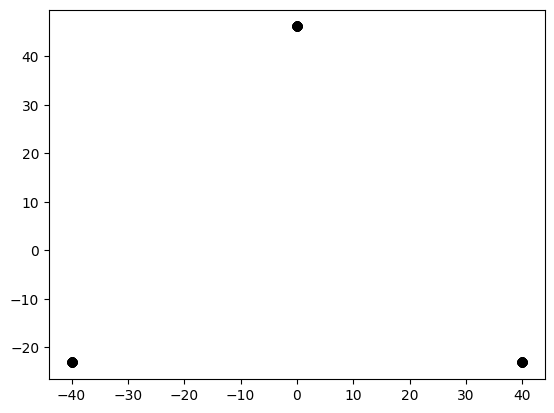

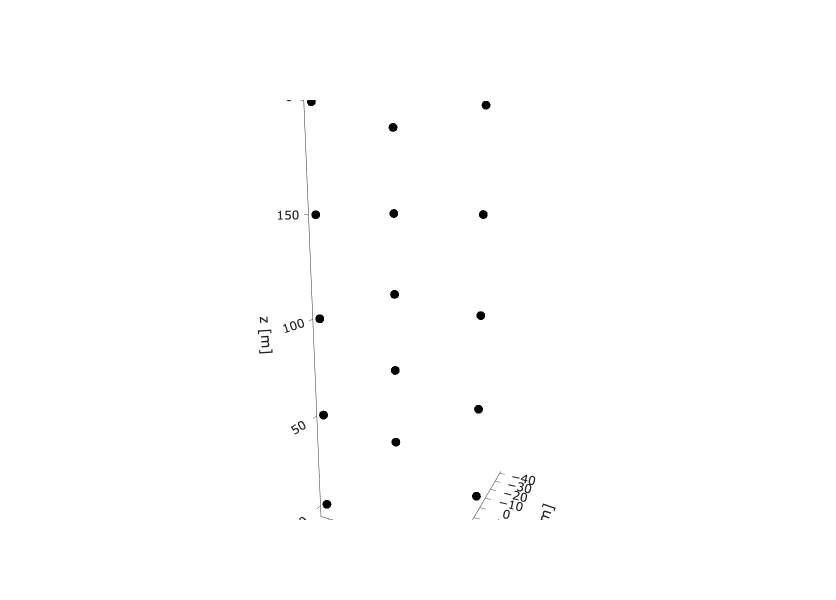

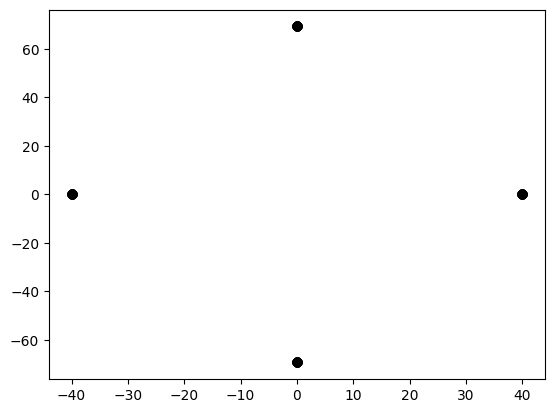

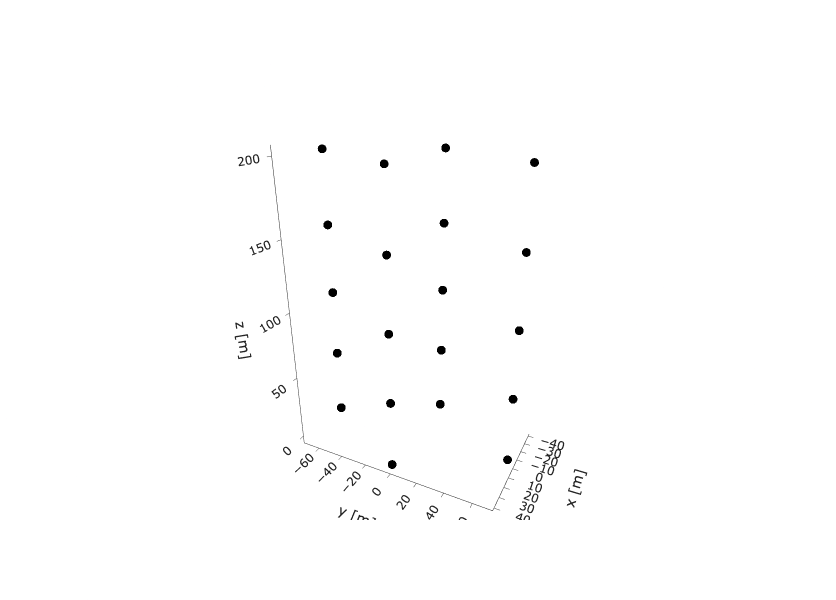

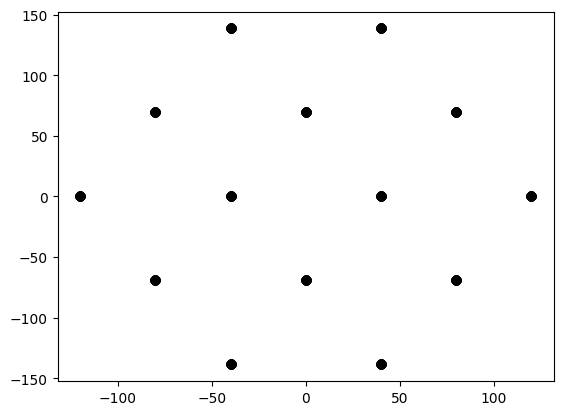

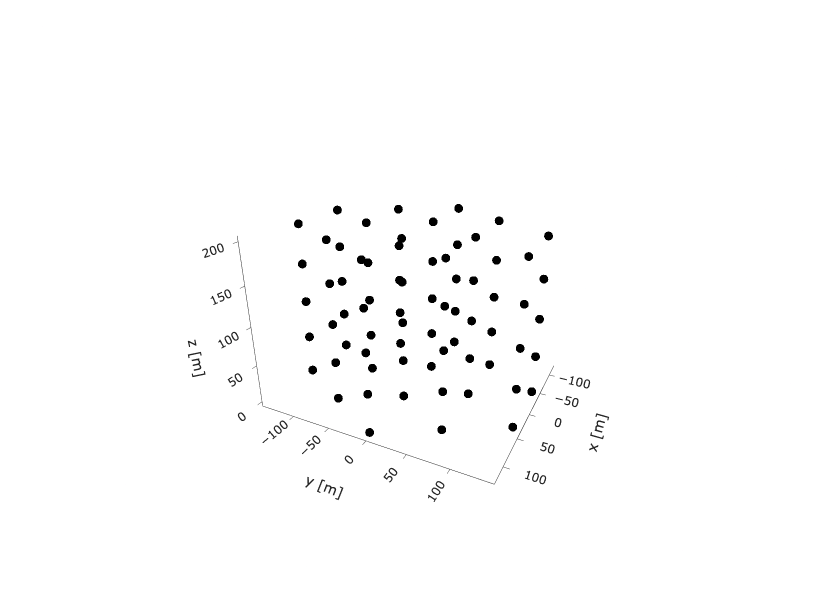

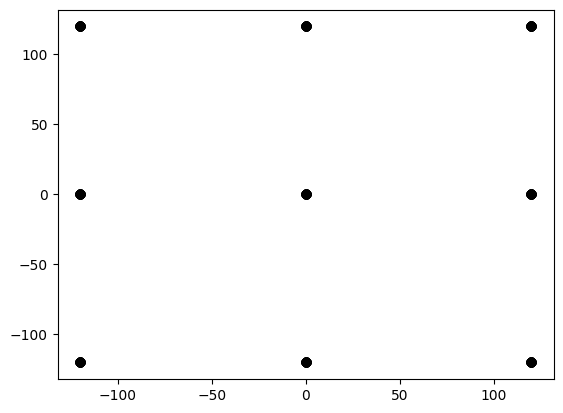

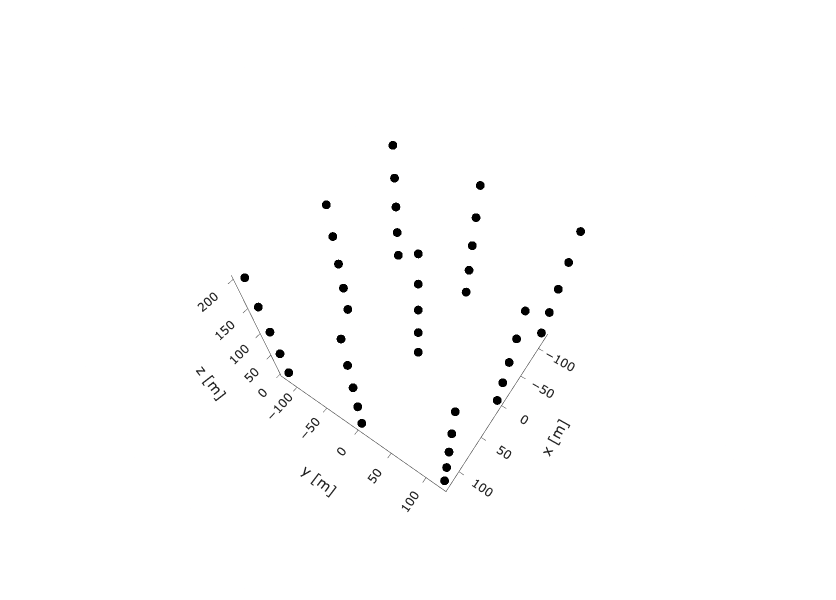

In [17]:
path='plot/'
files=os.listdir(path)
for file in files:
    f_path=f'{path}{file}'
    c=HDF5StorageConfiguration(data_path=f_path)
    c=Collection(c)
    with c:
        detector=c.storage.get_detector()
    x=detector.df['module_location_x']
    y=detector.df['module_location_y']
    plt.scatter(x,y, c='black')
    plt.show()
    fig=get_detector_scatter3ds(detector)
    fig.show()

In [27]:
record_id=records.df['record_id']
hits.get_by_record_ids([record_id[0]])

Hits(df=           time  string_id  module_id  pmt_id  record_id  type
0    227.331288          2          2       1          0     1
1    237.565049          2          2       1          0     1
2    228.880306          2          2       1          0     1
3    237.194640          2          2       1          0     1
4    227.443701          2          2       1          0     1
..          ...        ...        ...     ...        ...   ...
722  410.490772          2          4      14          0     1
723  414.137428          2          4      14          0     1
724  414.045435          2          4      14          0     1
725  426.013009          2          4      14          0     1
726  410.432915          2          4      14          0     1

[727 rows x 6 columns])

In [34]:
import warnings
warnings.filterwarnings("ignore")


In [41]:
records.df

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
0,-75.677553,114.936362,120.112992,-0.452195,0.363121,0.814655,0,100.0,3000.0,0.0,1,11,NaN


In [ ]:
C_P='/u/arego/project/Experimenting/data/LargeCascades/15records/20.h5'
c=HDF5StorageConfiguration(data_path=C_P)
c=Collection(c)
with c:
    records=c.storage.get_records()
    record_ids=records.df['record_id']
    detector=c.storage.get_detector()
    hits=c.storage.get_hits()
    sources=c.storage.get_sources()
    
fig=get_detector_scatter3ds(detector)
fig.show()    

for record_id in [13,14]:
    
    display(records.df[records.df['record_id']==record_id])

    hit=hits.get_by_record_ids([record_id])
    source=sources.get_by_record_ids([record_id])
    fig=get_detector_scatter3ds(detector ,
            include_pmts = True,
            include_modules= False,
            hits = hit,
            sources  = source,
            size= 5,
            start_time = 0.0,
            end_time = hits.df['time'].max(),
            pmt_opacity = 0.6)
    fig.show()   

In [ ]:
C_T='/u/arego/project/Experimenting/data/LargeStarting/15records/0.h5'
c=HDF5StorageConfiguration(data_path=C_T)
c=Collection(c)
with c:
    records=c.storage.get_records()
    record_ids=records.df['record_id']
    detector=c.storage.get_detector()
    hits=c.storage.get_hits()
    sources=c.storage.get_sources()
    
fig=get_detector_scatter3ds(detector)
fig.show()    

for record_id in record_ids:
    
    display(records.df[records.df['record_id']==record_id])

    hit=hits.get_by_record_ids([record_id])
    source=sources.get_by_record_ids([record_id])
    fig=get_detector_scatter3ds(detector ,
            include_pmts = True,
            include_modules= False,
            hits = hit,
            sources  = source,
            size= 5,
            start_time = 0.0,
            end_time = hits.df['time'].max(),
            pmt_opacity = 0.6)
    fig.show()   

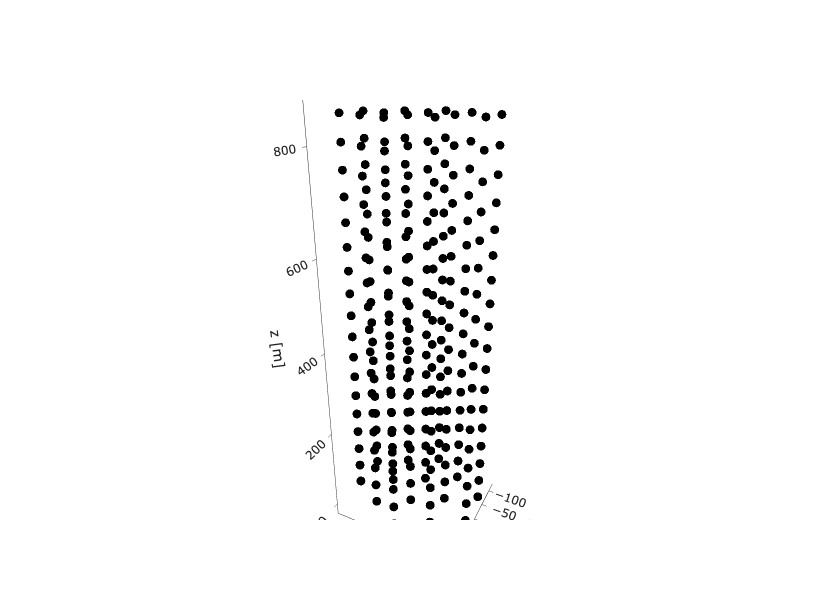

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
0,-128.945585,-70.231059,1000.0,0.390198,0.070173,-0.918053,2,139.125691,3000.0,0.0,2,11,NaN


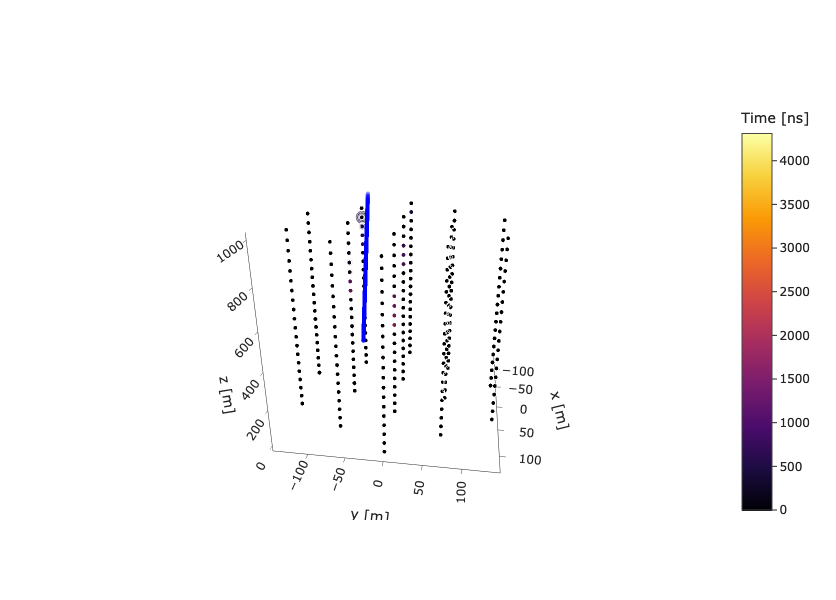

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
1,129.647447,-144.615852,665.288295,0.555475,0.099896,0.825511,5,156546.917481,3000.0,0.0,2,11,NaN


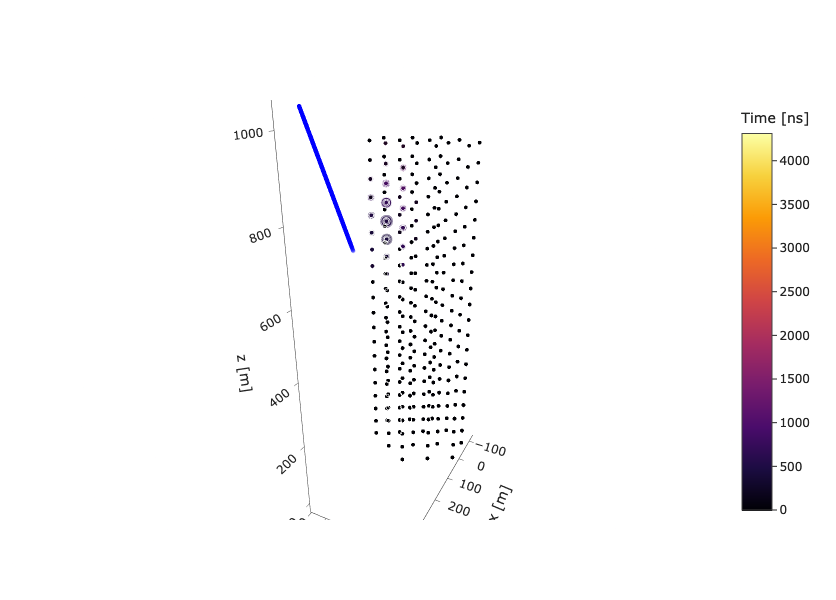

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
2,-3.404633,194.192208,574.196615,0.961567,0.172928,0.213272,6,13280.829926,3000.0,0.0,2,11,NaN


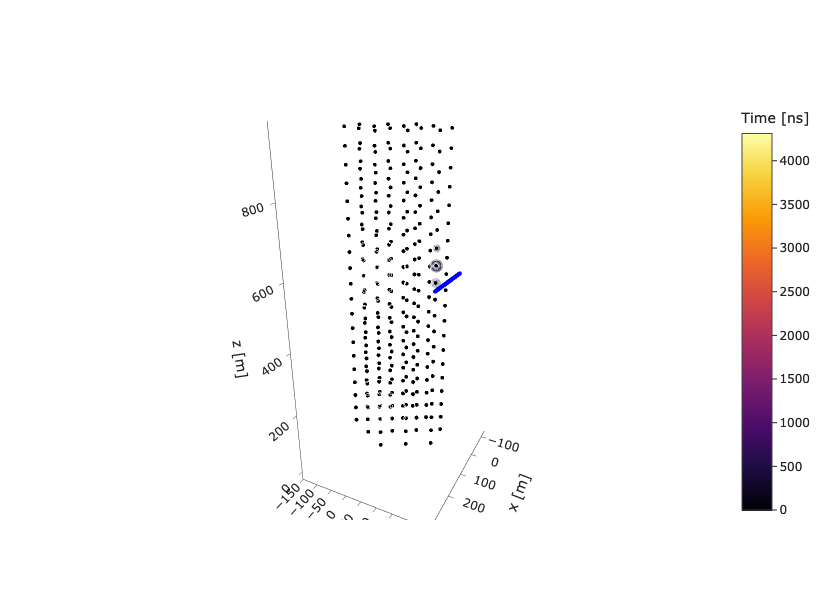

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
3,-178.509826,-76.527427,752.968462,0.980457,0.176325,0.08725,8,7992.5888,3000.0,0.0,2,11,NaN


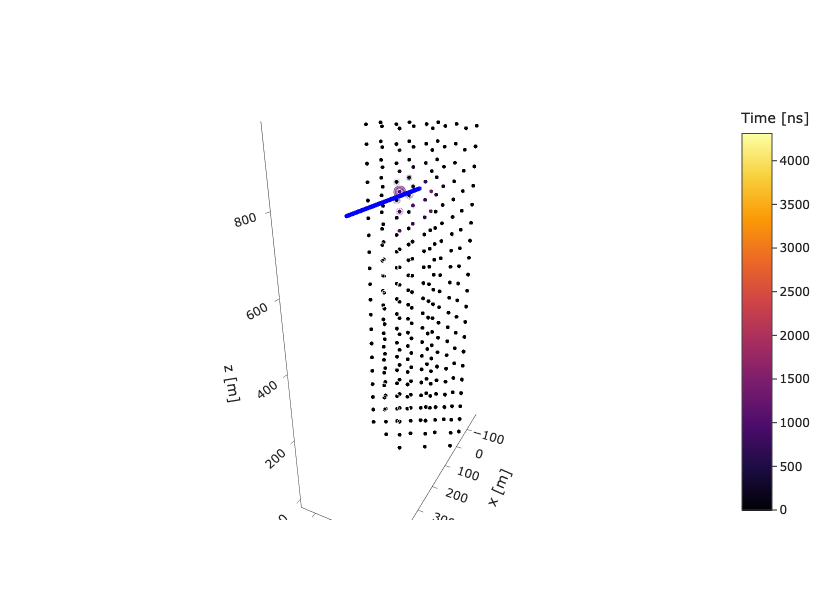

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
4,-157.457721,-113.706953,-882.86393,0.485015,0.087225,0.870145,9,187393.051486,3000.0,0.0,2,11,NaN


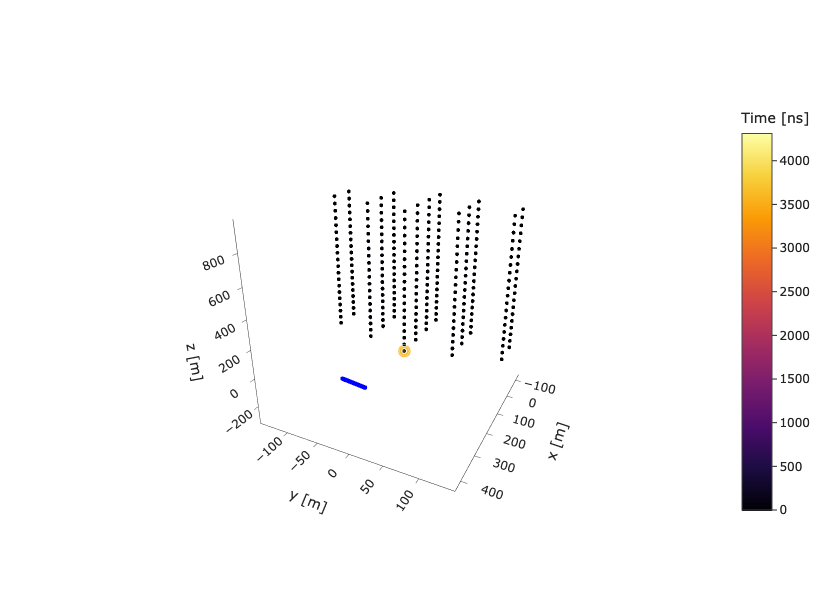

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
5,-179.876725,-73.25687,-327.765879,0.762967,0.137212,0.631707,10,71694.763987,3000.0,0.0,2,11,NaN


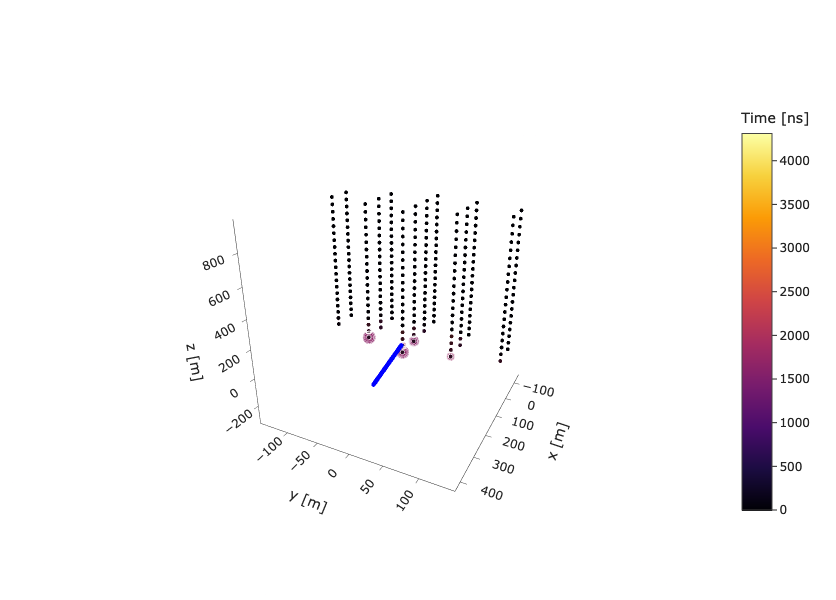

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
6,-111.094723,-20.117629,1000.0,0.354631,0.063777,-0.932829,13,131.083948,3000.0,0.0,2,11,NaN


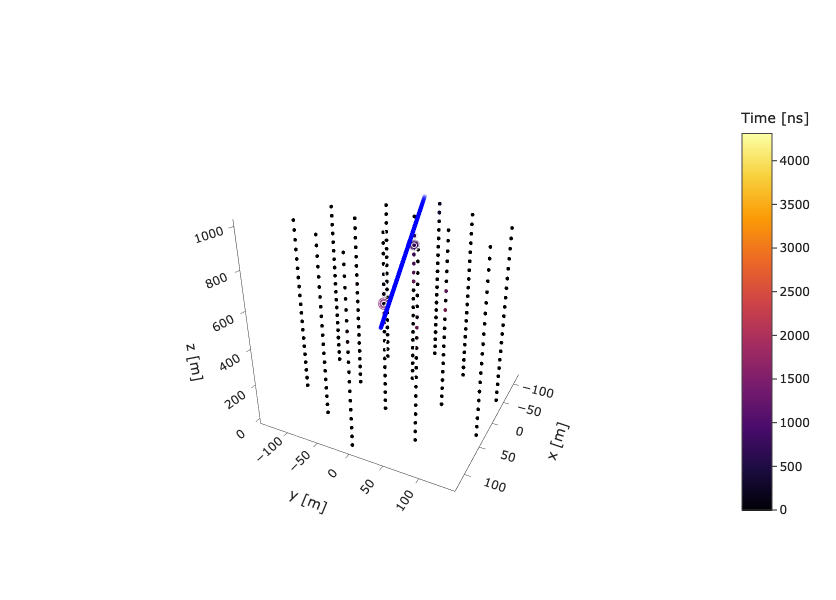

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
7,-30.810015,-191.762739,-99.321267,0.87425,0.157225,0.459311,14,35792.667211,3000.0,0.0,2,11,NaN


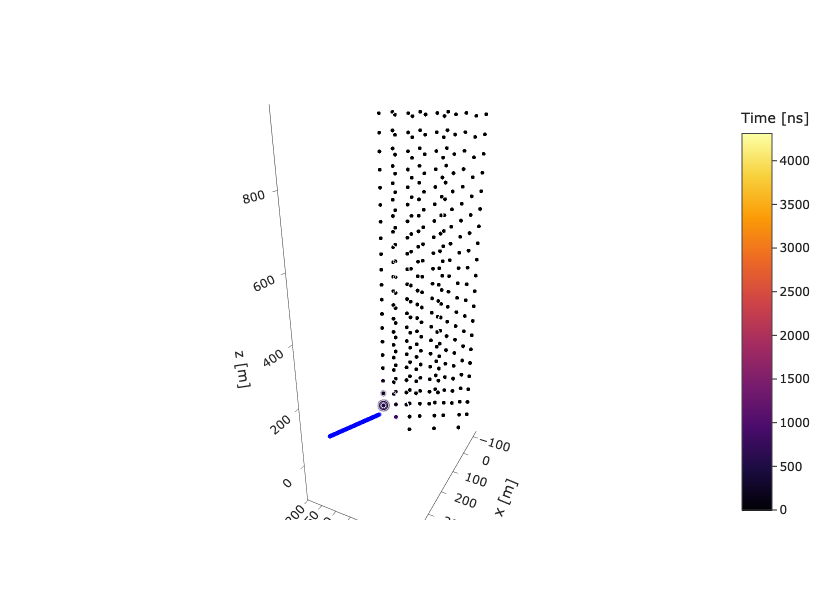

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
8,-5.982951,194.129878,458.030234,-0.173378,-0.957437,0.23077,18,18414.64244,3000.0,0.0,2,11,NaN


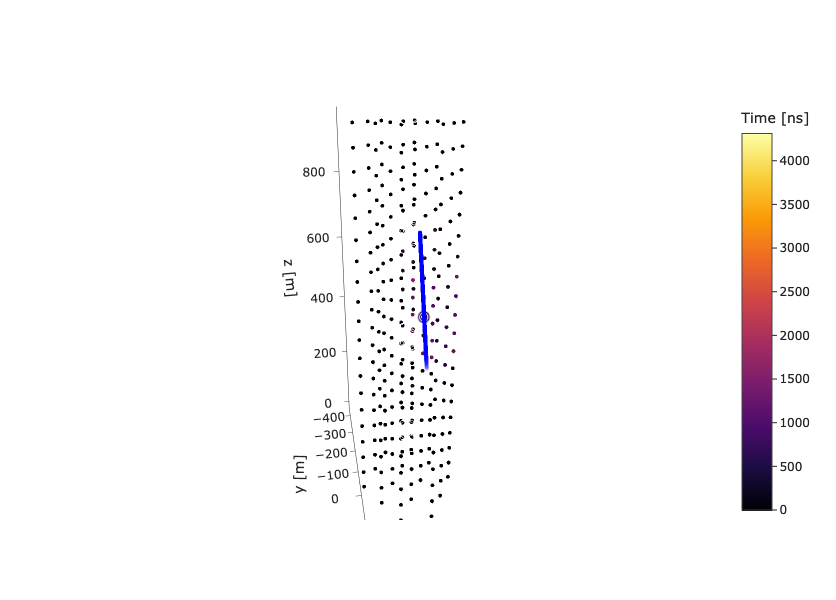

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
9,-61.242561,184.313738,854.847857,-0.173298,-0.956997,-0.232645,19,14251.08368,3000.0,0.0,2,11,NaN


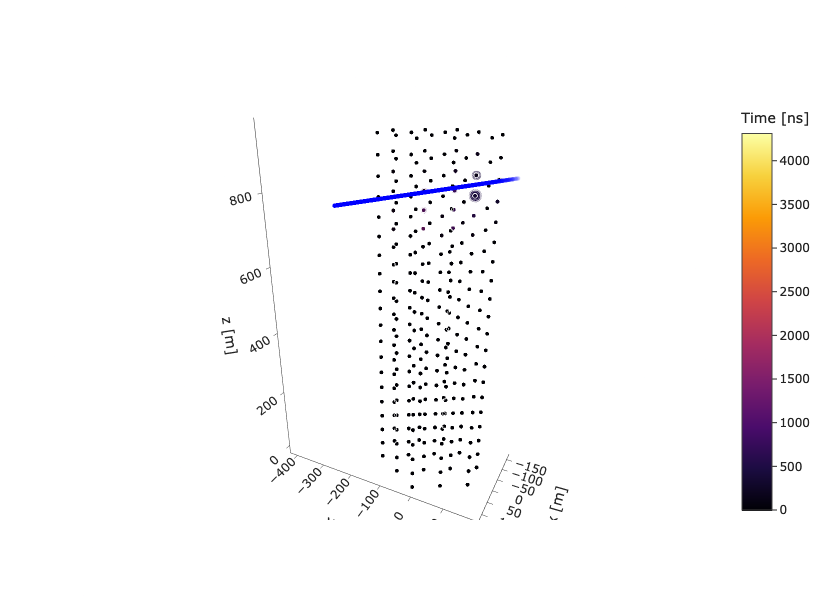

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
10,48.247704,-188.1339,935.85238,-0.018798,-0.103806,0.99442,20,2202.274448,3000.0,0.0,2,11,NaN


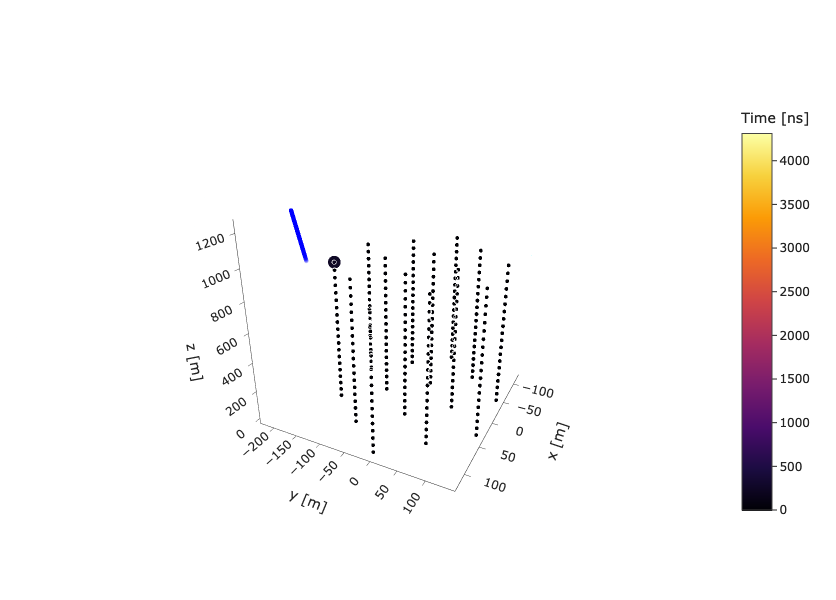

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
11,-193.993084,9.428059,-970.58739,-0.04886,-0.269819,0.961671,21,309196.646701,3000.0,0.0,2,11,NaN


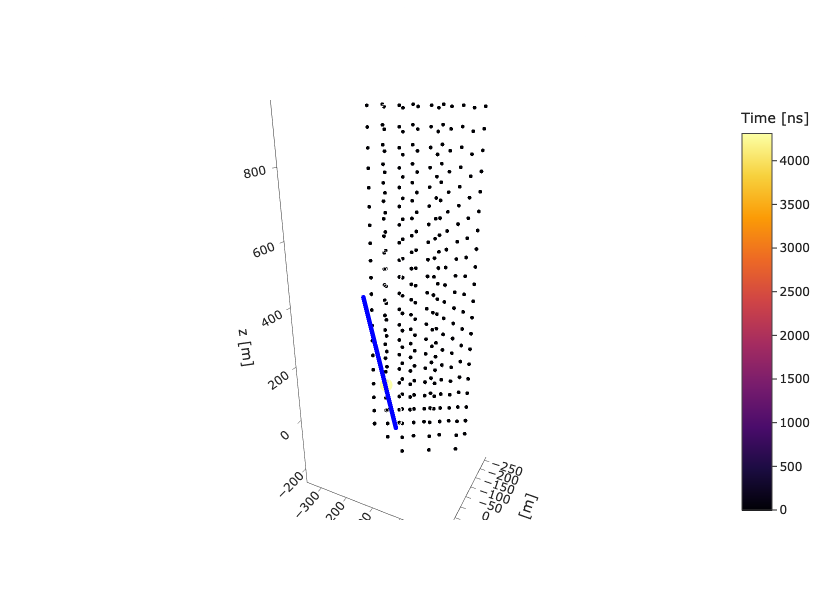

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
12,3.145033,-194.196586,727.28018,-0.165465,-0.913739,0.371084,22,270971.54385,3000.0,0.0,2,11,NaN


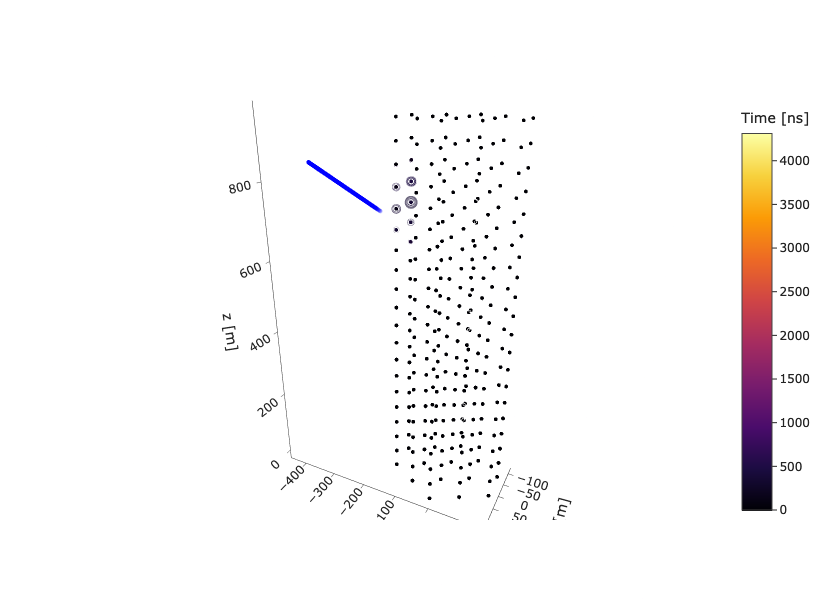

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
13,-35.56872,-190.937349,962.39008,-0.169928,-0.938388,0.300919,23,25084.00887,3000.0,0.0,2,11,NaN


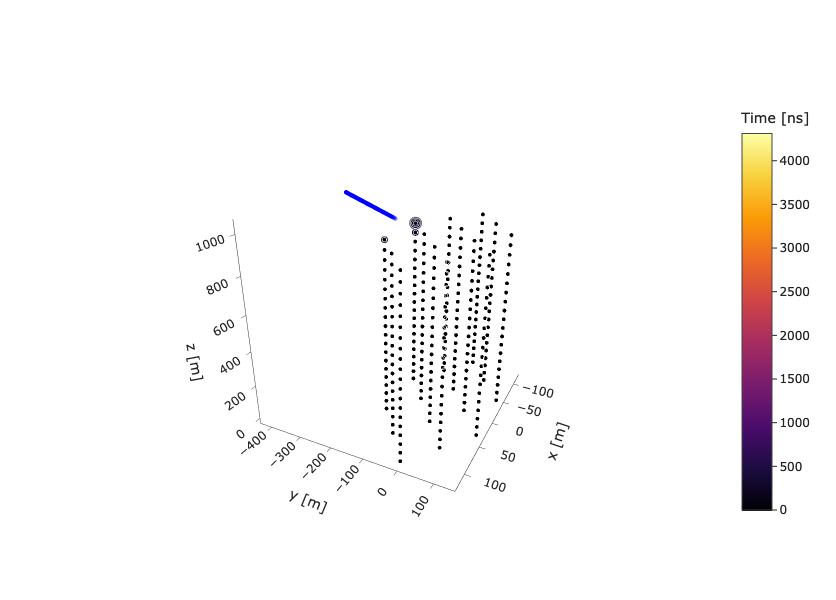

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
14,-189.333087,43.303433,914.420359,-0.165047,-0.911433,0.376893,24,18906.34014,3000.0,0.0,2,11,NaN


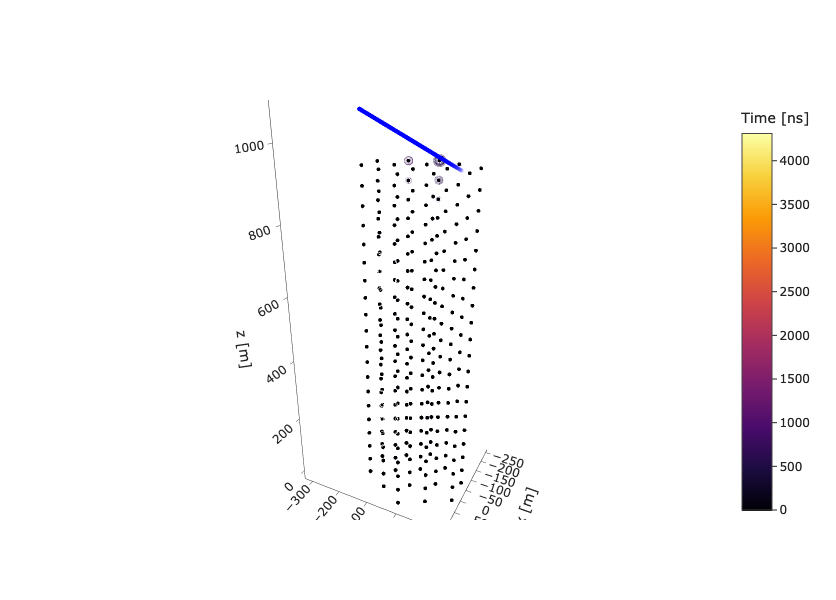

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
15,193.225407,-19.650624,464.012391,-0.579803,0.720968,-0.379516,26,33512.682395,3000.0,0.0,2,11,NaN


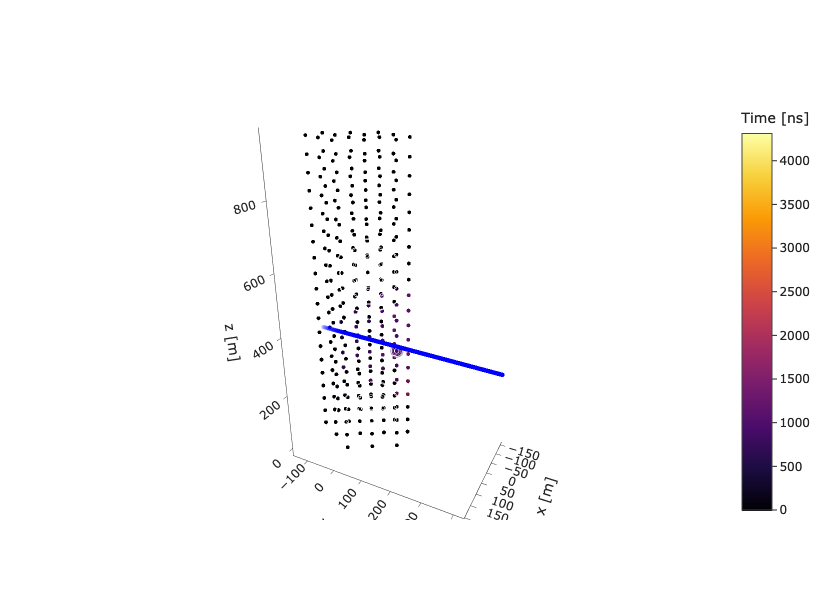

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
16,-47.040463,-188.43938,228.746494,-0.626438,0.778957,-0.028329,27,6898.269045,3000.0,0.0,2,11,NaN


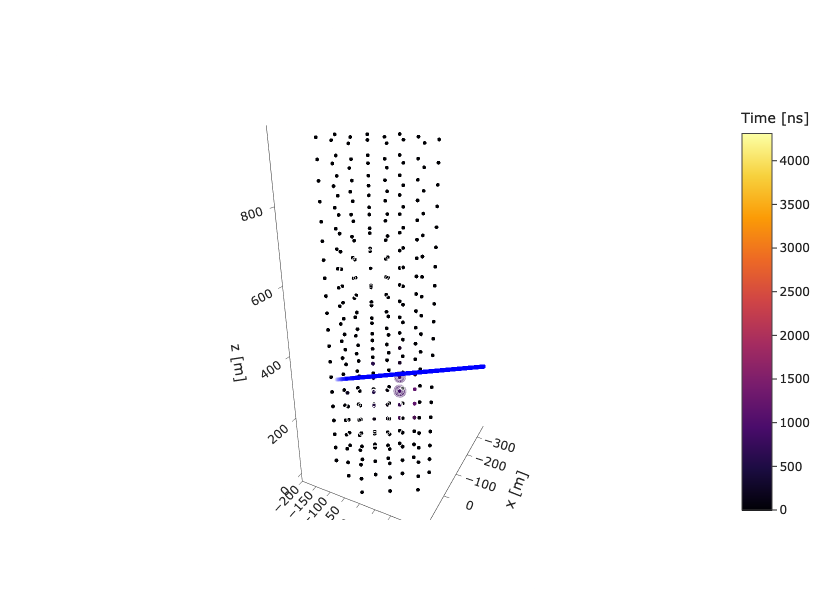

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
17,-21.610775,45.26222,1000.0,-0.519303,0.842531,0.14306,28,129779.895529,3000.0,0.0,2,11,NaN


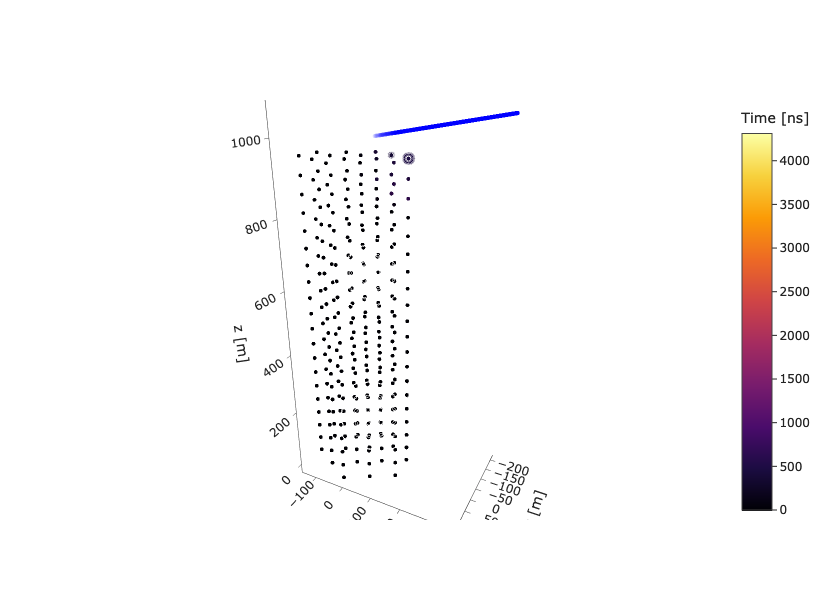

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
18,-64.745031,-183.112769,120.951904,0.480948,-0.84142,0.246374,29,12024.03151,3000.0,0.0,2,11,NaN


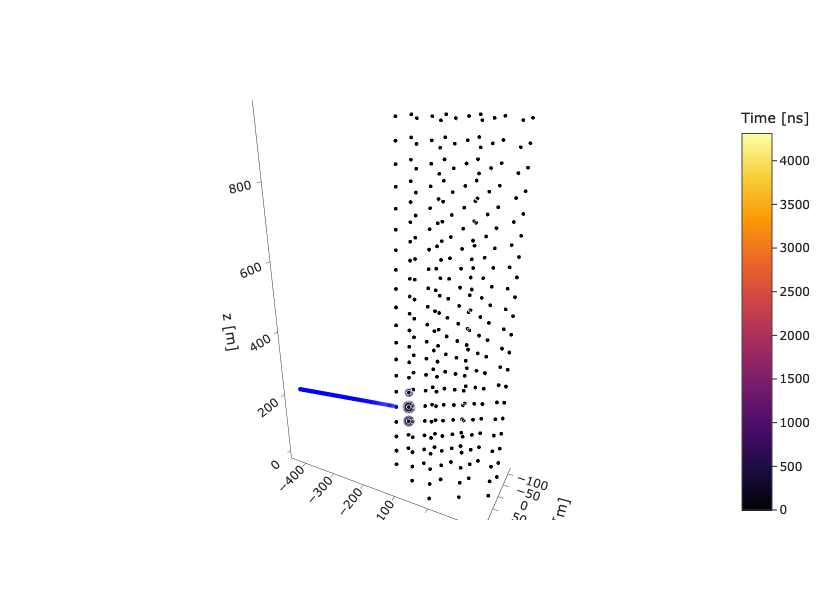

,location_x,location_y,location_z,orientation_x,orientation_y,orientation_z,record_id,energy,length,time,type,particle_id,duration
19,142.07833,-132.423387,105.223021,0.614,0.236732,0.752968,30,130605.128863,3000.0,0.0,2,11,NaN


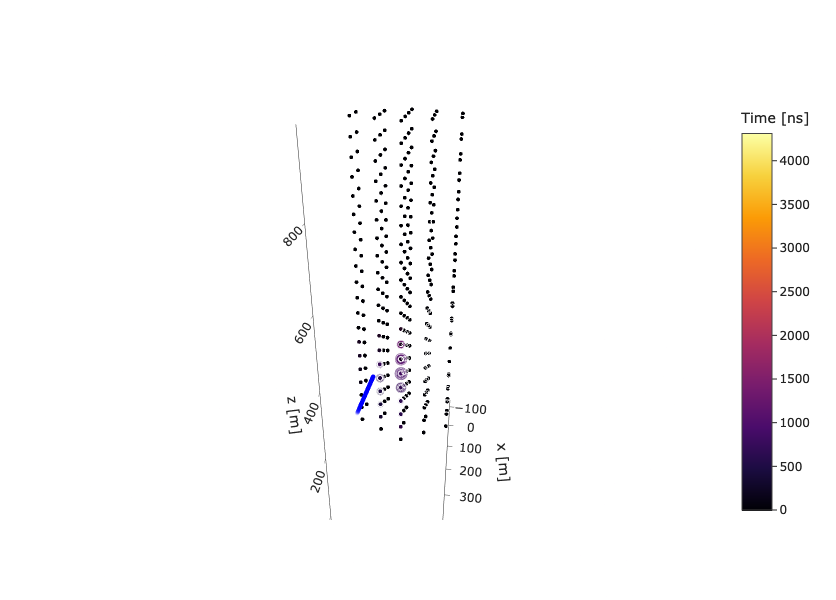

In [46]:
C_T='/u/arego/project/Experimenting/data/LargeTrack/20records/0.h5'
c=HDF5StorageConfiguration(data_path=C_T)
c=Collection(c)
with c:
    records=c.storage.get_records()
    record_ids=records.df['record_id']
    detector=c.storage.get_detector()
    hits=c.storage.get_hits()
    sources=c.storage.get_sources()
    
fig=get_detector_scatter3ds(detector)
fig.show()    

for record_id in record_ids:
    
    display(records.df[records.df['record_id']==record_id])

    hit=hits.get_by_record_ids([record_id])
    source=sources.get_by_record_ids([record_id])
    fig=get_detector_scatter3ds(detector ,
            include_pmts = True,
            include_modules= False,
            hits = hit,
            sources  = source,
            size= 5,
            start_time = 0.0,
            end_time = hits.df['time'].max(),
            pmt_opacity = 0.6)
    fig.show()   